1. 만든 데이터 불러와서 그래프 그리기
    - fan에 대해서 res_type별로 
        - 모델별로 그래프 그리기
        - Noise별 그래프 그리기
            - 각 Noise별 id별로 평균내서 그리기

In [4]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import glob

from whole_best_vis import *

import warnings
warnings.filterwarnings('ignore')

In [5]:
data = pd.read_csv('/project/time_series/model_all_cases.csv')

# Preprocessing
- 'Noise'칼럼 만들기 : '0', '6', '_6'
- 'Model'만들기 : 'id_00', id_02', 'id_04', 'id_06'
- 'Object'칼럼 만들기 : 'fan', 'valve', .. 등

In [6]:
def make_Object(x):
    if x[:6] == 'fan_0_':
        object = '0'
    elif x[:6] == 'fan_6_':
        object = '6'
    else :
        object = '_6'
    return object

In [7]:
data['Noise'] = data['Model'].apply(make_Object)
data['Object'] = data['Model'].apply(lambda x : x.split('_')[0])
data['Model'] = data['Model'].apply(lambda x : x[-5:])
data = data[['Object','Noise', 'Model', 'sampling_way', 'target_sr', 'acc', 'recall', 'precision','f1', 'auc_score']]
data.head()

,Object,Noise,Model,sampling_way,target_sr,acc,recall,precision,f1,auc_score
0,fan,0,id_00,abs_max(our_custom),64,0.820,0.390,0.970,0.557,0.744
1,fan,0,id_00,abs_max(our_custom),80,0.820,0.390,0.970,0.557,0.731
2,fan,0,id_00,abs_max(our_custom),100,0.824,0.390,1.000,0.561,0.766
3,fan,0,id_00,abs_max(our_custom),125,0.810,0.366,0.938,0.526,0.786
4,fan,0,id_00,abs_max(our_custom),128,0.817,0.378,0.969,0.544,0.748


In [8]:
resample_li = list(set(data['sampling_way']))
print('resample_li 의 개수 : ', len(resample_li))
print(resample_li)

resample_li 의 개수 :  16
['scipy', 'kaiser_best', 'sinc_fastest', 'soxr_mq', 'soxr_hq', 'soxr_qq', 'kaiser_fast', 'linear', 'soxr_lq', 'polyphase', 'zero_order_hold', 'sinc_medium', 'fft', 'abs_max(our_custom)', 'soxr_vhq', 'sinc_best']


# 시각화하기

## whole_best_vis()사용방법(모델별로 보기)
- id별로 보고싶을때
    - 원하는 Object, 원하는 sampling_way, 원하는 Noise 로 데이터를 뽑은 후, 함수에 넣어주자


In [9]:
Object = 'fan'
sampling_way = 'soxr_hq'
Noise = '0'

input_df = data[(data['Object'] == Object)&(data['sampling_way'] == sampling_way)&(data['Noise'] == Noise)]
input_df.head(1)

,Object,Noise,Model,sampling_way,target_sr,acc,recall,precision,f1,auc_score
252,fan,0,id_00,soxr_hq,64,1.0,1.0,1.0,1.0,1.0


In [10]:
whole_best_vis(input_df, sampling_way)

(         acc  recall  precision  auc_score     f1
 id_00  1.000   1.000        1.0      1.000  1.000
 id_02  0.749   0.097        1.0      0.632  0.165
 id_04  0.910   0.657        1.0      0.963  0.786
 id_06  0.946   0.792        1.0      0.996  0.884,
         acc  recall  precision  auc_score    f1
 id_00    64      64         64         64    64
 id_02   160     128       1000        128   128
 id_04   100     100       1600        100   100
 id_06  1600    1600       1600        800  1600)

In [13]:
## 확인
check_noise = '0'
check_ID = 'id_00'
check_target_sr = 80
check_sampling_wayway = 'sinc_medium'



data[(data['Noise'] == check_noise)&(data['Model'] == check_ID)&(data['target_sr'] == check_target_sr)&(data['sampling_way'] == check_sampling_wayway)]

,Object,Noise,Model,sampling_way,target_sr,acc,recall,precision,f1,auc_score
190,fan,0,id_00,sinc_medium,80,0.996,0.988,1.0,0.994,1.0


In [14]:
input_df

,Object,Noise,Model,sampling_way,target_sr,acc,recall,precision,f1,auc_score
252,fan,0,id_00,soxr_hq,64,1.000,1.000,1.000,1.000,1.000
253,fan,0,id_00,soxr_hq,80,0.989,0.963,1.000,0.981,1.000
254,fan,0,id_00,soxr_hq,100,0.982,0.951,0.987,0.969,0.999
255,fan,0,id_00,soxr_hq,125,0.933,0.793,0.970,0.872,0.990
256,fan,0,id_00,soxr_hq,128,0.937,0.793,0.985,0.878,0.991
...,...,...,...,...,...,...,...,...,...,...
1276,fan,0,id_06,soxr_hq,3200,0.938,0.764,1.000,0.866,0.985
1277,fan,0,id_06,soxr_hq,4000,0.928,0.722,1.000,0.839,0.992
1278,fan,0,id_06,soxr_hq,8000,0.920,0.694,1.000,0.820,0.973
1279,fan,0,id_06,soxr_hq,10000,0.920,0.694,1.000,0.820,0.992


# F1&BEST

In [17]:
data = pd.read_csv('/project/time_series/model_all_cases.csv')

def make_Object(x):
    if x[:6] == 'fan_0_':
        object = '0'
    elif x[:6] == 'fan_6_':
        object = '6'
    else :
        object = '_6'
    return object
data['Noise'] = data['Model'].apply(make_Object)
data['Object'] = data['Model'].apply(lambda x : x.split('_')[0])
data['Model'] = data['Model'].apply(lambda x : x[-5:])
data = data[['Object','Noise', 'Model', 'sampling_way', 'target_sr', 'acc', 'recall', 'precision','f1', 'auc_score']]
data.head()

,Object,Noise,Model,sampling_way,target_sr,acc,recall,precision,f1,auc_score
0,fan,0,id_00,abs_max(our_custom),64,0.820,0.390,0.970,0.557,0.744
1,fan,0,id_00,abs_max(our_custom),80,0.820,0.390,0.970,0.557,0.731
2,fan,0,id_00,abs_max(our_custom),100,0.824,0.390,1.000,0.561,0.766
3,fan,0,id_00,abs_max(our_custom),125,0.810,0.366,0.938,0.526,0.786
4,fan,0,id_00,abs_max(our_custom),128,0.817,0.378,0.969,0.544,0.748


In [18]:
data

,Object,Noise,Model,sampling_way,target_sr,acc,recall,precision,f1,auc_score
0,fan,0,id_00,abs_max(our_custom),64,0.820,0.390,0.970,0.557,0.744
1,fan,0,id_00,abs_max(our_custom),80,0.820,0.390,0.970,0.557,0.731
2,fan,0,id_00,abs_max(our_custom),100,0.824,0.390,1.000,0.561,0.766
3,fan,0,id_00,abs_max(our_custom),125,0.810,0.366,0.938,0.526,0.786
4,fan,0,id_00,abs_max(our_custom),128,0.817,0.378,0.969,0.544,0.748
...,...,...,...,...,...,...,...,...,...,...
4027,fan,6,id_06,soxr_qq,3200,0.967,0.875,1.000,0.933,0.999
4028,fan,6,id_06,soxr_qq,4000,0.971,0.889,1.000,0.941,0.996
4029,fan,6,id_06,soxr_qq,8000,0.964,0.875,0.984,0.926,0.999
4030,fan,6,id_06,soxr_qq,10000,0.975,0.903,1.000,0.949,0.996


In [19]:
data.columns

Index(['Object', 'Noise', 'Model', 'sampling_way', 'target_sr', 'acc',
       'recall', 'precision', 'f1', 'auc_score'],
      dtype='object')

In [20]:
data = data[['Object', 'Noise', 'Model', 'sampling_way', 'target_sr', 'f1']]
data.head()

,Object,Noise,Model,sampling_way,target_sr,f1
0,fan,0,id_00,abs_max(our_custom),64,0.557
1,fan,0,id_00,abs_max(our_custom),80,0.557
2,fan,0,id_00,abs_max(our_custom),100,0.561
3,fan,0,id_00,abs_max(our_custom),125,0.526
4,fan,0,id_00,abs_max(our_custom),128,0.544


In [21]:
data

,Object,Noise,Model,sampling_way,target_sr,f1
0,fan,0,id_00,abs_max(our_custom),64,0.557
1,fan,0,id_00,abs_max(our_custom),80,0.557
2,fan,0,id_00,abs_max(our_custom),100,0.561
3,fan,0,id_00,abs_max(our_custom),125,0.526
4,fan,0,id_00,abs_max(our_custom),128,0.544
...,...,...,...,...,...,...
4027,fan,6,id_06,soxr_qq,3200,0.933
4028,fan,6,id_06,soxr_qq,4000,0.941
4029,fan,6,id_06,soxr_qq,8000,0.926
4030,fan,6,id_06,soxr_qq,10000,0.949


In [23]:
ID='id_00'
ii = 64
data_new[(data_new['Model'] == ID)&(data_new['target_sr'] == ii)]

NameError: name 'data_new' is not defined

In [24]:
resample_li = list(set(data['sampling_way']))
len(resample_li)

16

In [26]:

def noise_per_plot(sampling_way:str):

    data_new= data[data['sampling_way'] == sampling_way]
    ### 노이즈 보고 싶으면 여기 조건 추가하기 
    target_sr_li = sorted(list(set(data_new['target_sr'])))
    ID_li = list(set(data_new['Model']))
    color_li = ['r', 'y', 'g', 'b']

    fig = plt.figure(figsize=(30,10), dpi=400)
    axs = fig.subplots(1,2)


    maxvalue_li = []
    maxind_li = []
    
    for ID, color in zip(ID_li,color_li):
        
        value_dic = {}
        for ii in target_sr_li : 

            a = np.mean(data_new[(data_new['Model'] == ID)&(data_new['target_sr'] == ii)]['f1'])
            a = np.around(a, 3)
            value_dic[f'{ii}'] = a

        df = pd.DataFrame(list(value_dic.items()), columns=['target_sr', 'value'])
        maxind = np.argmax(df['value'])
        maxind_li.append(target_sr_li[maxind])
        
        maxvalue = df['value'].iloc[maxind]
        maxvalue_li.append(maxvalue)
    
        sns.pointplot(x = "target_sr", y='value',data = df ,label=ID, color=color, ax = axs[0])
        axs[0].axvline(maxind, color=color, linestyle='--', linewidth=2)

    axs[1].bar(range(len(maxvalue_li)), maxvalue_li, color=color_li)
    for ii, ind in enumerate(maxind_li) :
        axs[1].text(ii, maxvalue_li[ii], '{}'.format(ind), ha='left', va='bottom', fontsize=15)
    axs[1].set_title('Best', fontsize=30)
    axs[1].set_xticks(range(len(maxvalue_li)))
    axs[1].set_xticklabels(['id_00', 'id_02', 'id_04', 'id_06'], fontsize=20)
            
        

    ##범례 나타내기
    variable_x = mpatches.Patch(color='r',label='id_00')
    variable_y = mpatches.Patch(color='y',label='id_02')
    variable_z = mpatches.Patch(color='g',label='id_04')
    variable_w = mpatches.Patch(color='b',label='id_06')
    _=axs[0].legend(handles=[variable_x, variable_y, variable_z,variable_w], loc='best', fontsize=20)

    X1 = range(len(data_new['target_sr'].values))
    _=axs[0].set_xticklabels(target_sr_li, fontsize=20, rotation=45)
    _=axs[0].tick_params(axis='y', labelsize=20)
    _=axs[0].set_title('{}'.format(sampling_way), fontsize=30)
    
    return maxvalue_li, maxind_li

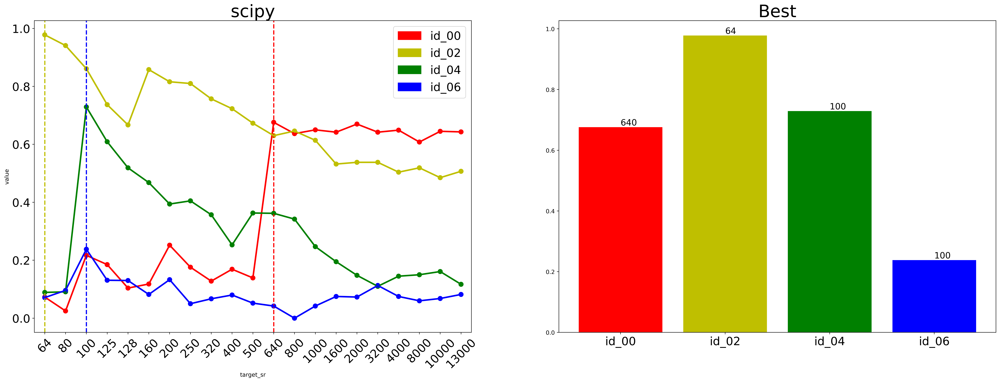

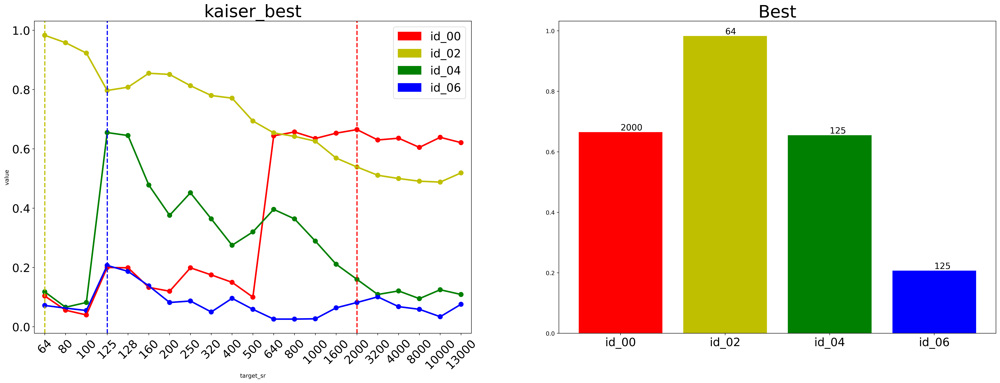

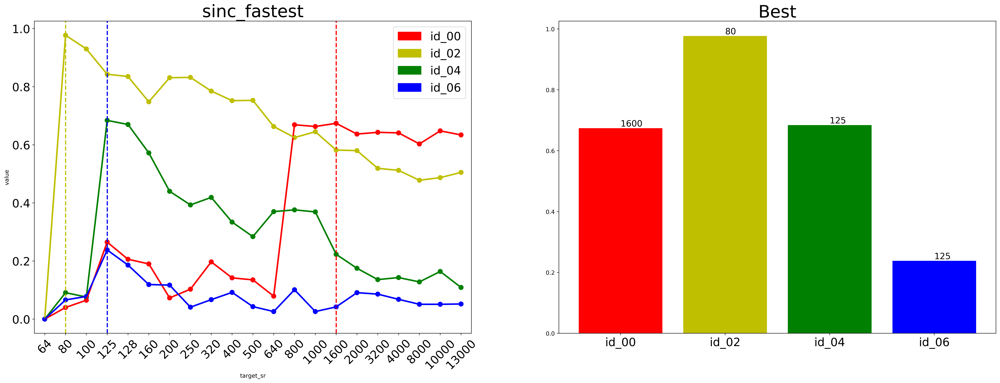

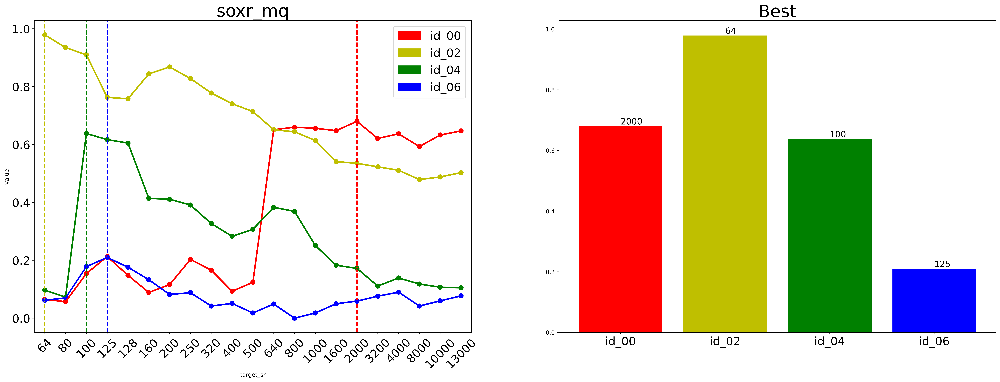

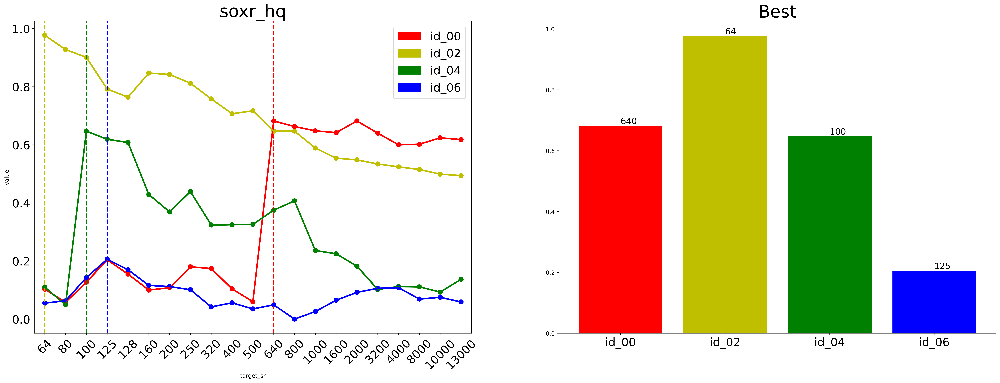

...

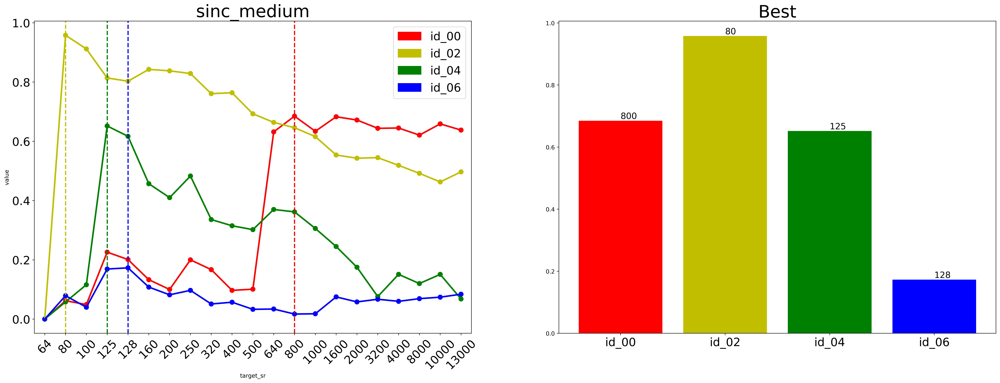

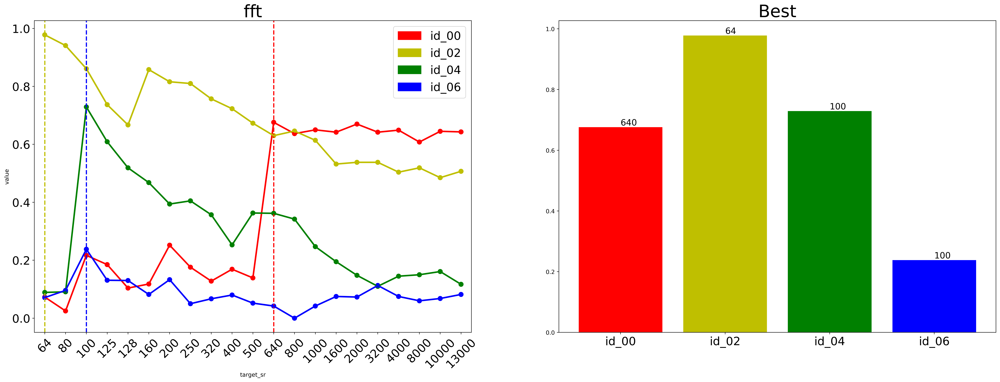

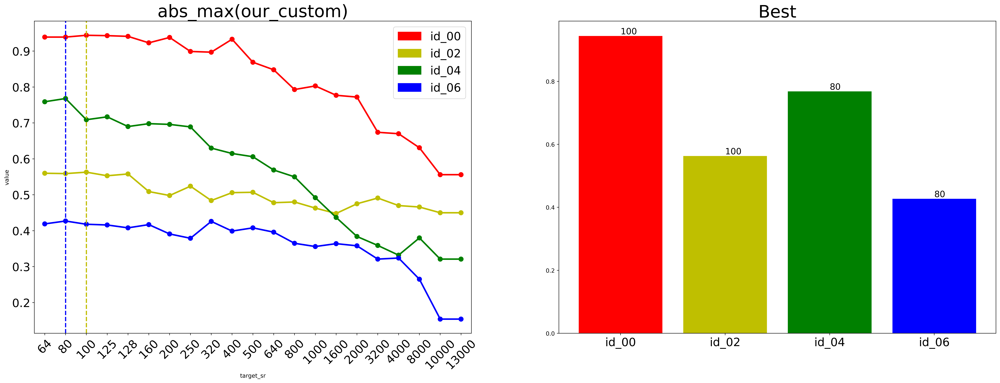

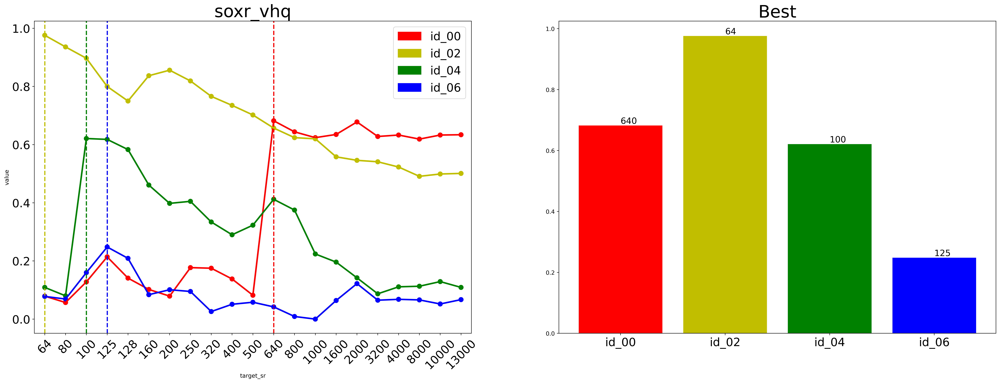

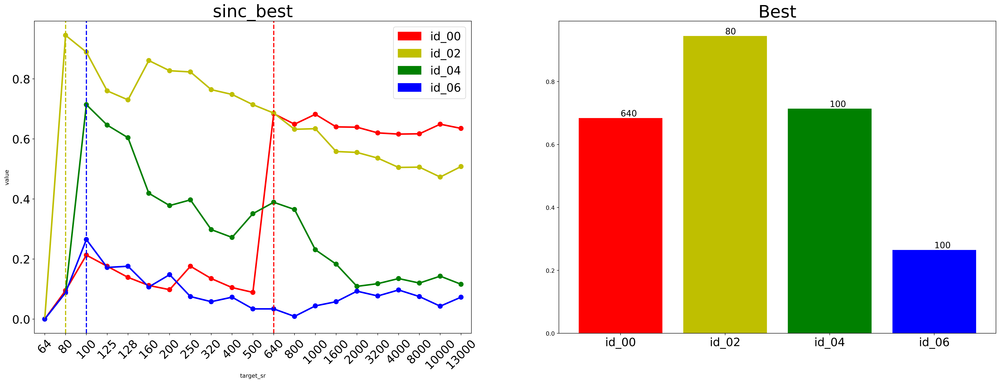

In [28]:
for res in resample_li :

    noise_per_plot(res)

# 한 화면에 각 모델의 resample기법이 보여지게끔 그리기
   - 총 4개의 plot이 그려짐

## Per Model

In [29]:
data = pd.read_csv('/project/time_series/model_all_cases.csv')

def make_Object(x):
    if x[:6] == 'fan_0_':
        object = '0'
    elif x[:6] == 'fan_6_':
        object = '6'
    else :
        object = '_6'
    return object
data['Noise'] = data['Model'].apply(make_Object)
data['Object'] = data['Model'].apply(lambda x : x.split('_')[0])
data['Model'] = data['Model'].apply(lambda x : x[-5:])
data = data[['Object','Noise', 'Model', 'sampling_way', 'target_sr', 'acc', 'recall', 'precision','f1', 'auc_score']]
data.head()

,Object,Noise,Model,sampling_way,target_sr,acc,recall,precision,f1,auc_score
0,fan,0,id_00,abs_max(our_custom),64,0.820,0.390,0.970,0.557,0.744
1,fan,0,id_00,abs_max(our_custom),80,0.820,0.390,0.970,0.557,0.731
2,fan,0,id_00,abs_max(our_custom),100,0.824,0.390,1.000,0.561,0.766
3,fan,0,id_00,abs_max(our_custom),125,0.810,0.366,0.938,0.526,0.786
4,fan,0,id_00,abs_max(our_custom),128,0.817,0.378,0.969,0.544,0.748


Model만 인자

In [30]:
def ModelPlot(Model:str):

    target_sr_li = sorted(list(set(data['target_sr'])))
    resample_li = sorted(list(set(data['sampling_way'])))

    dic = {}
    for sampling_way in resample_li:
        dic[sampling_way] = []

        for target_sr in target_sr_li:

            con_model = data['Model'] == Model
            con_sampling_way = data['sampling_way']==sampling_way
            con_trsr = data['target_sr'] == target_sr

            data_new = data[con_model&con_sampling_way&con_trsr]['f1']
            mu_val = np.around(data_new.mean(), 3)
            dic[sampling_way].append(mu_val)
    mu_val_df = pd.DataFrame(dic, index=target_sr_li)

    color_li = ['bisque', 'darkorange', 'burlywood', 'antiquewhite', 'gold', 'olive', 'yellow', 'ivory', 'lawngreen','rosybrown','coral',
                'chocolate', 'green', 'mediumturquoise', 'deepskyblue', 'indigo']

    fig = plt.figure(figsize=(20, 10))
    axs = fig.subplots(1,2)

    legend_li = []
    maxind_li = []
    maxvalue_li = []

    for column, color in zip(resample_li, color_li) :
        sns.pointplot(x = mu_val_df.index, y=column,data = mu_val_df ,label='{}'.format(column), color = color, ax=axs[0])

        maxind = np.argmax(mu_val_df[column])
        maxind_li.append(maxind)

        maxvalue = mu_val_df[column].iloc[maxind]
        maxvalue_li.append(maxvalue)

        axs[0].axvline(maxind, color=color, linestyle='--', linewidth=2)
        legend_li.append(mpatches.Patch(color=color,label='{}'.format(column)))

    _=axs[0].legend(handles=legend_li, loc='upper right',bbox_to_anchor=(1.2,1), fontsize=8)
    _=axs[0].set_ylabel('Value', fontsize=15)
    _=axs[0].set_xlabel('target_sr', fontsize=15)
    _=axs[0].set_ylim([0,1])


    _=axs[0].set_xticklabels(target_sr_li, fontsize=15, rotation=45)
    _=axs[0].tick_params(axis='y', labelsize=15)
    _=axs[0].set_title('{}'.format(Model), fontsize=30)

    _=axs[1].bar(range(len(maxind_li)), maxvalue_li, color=color_li)
    for ii, ind in enumerate(maxind_li) :
        axs[1].text(ii, maxvalue_li[ii], '{}'.format(target_sr_li[ind]), ha='left', va='bottom', fontsize=15)


    _=axs[1].set_title('Best', fontsize=30)
    _=axs[1].set_xticks(range(len(maxvalue_li)))
    _=axs[1].set_xticklabels(resample_li, fontsize=13, rotation=45)

In [31]:
sorted(resample_li)

['abs_max(our_custom)',
 'fft',
 'kaiser_best',
 'kaiser_fast',
 'linear',
 'polyphase',
 'scipy',
 'sinc_best',
 'sinc_fastest',
 'sinc_medium',
 'soxr_hq',
 'soxr_lq',
 'soxr_mq',
 'soxr_qq',
 'soxr_vhq',
 'zero_order_hold']

In [32]:
resample_li

['scipy',
 'kaiser_best',
 'sinc_fastest',
 'soxr_mq',
 'soxr_hq',
 'soxr_qq',
 'kaiser_fast',
 'linear',
 'soxr_lq',
 'polyphase',
 'zero_order_hold',
 'sinc_medium',
 'fft',
 'abs_max(our_custom)',
 'soxr_vhq',
 'sinc_best']

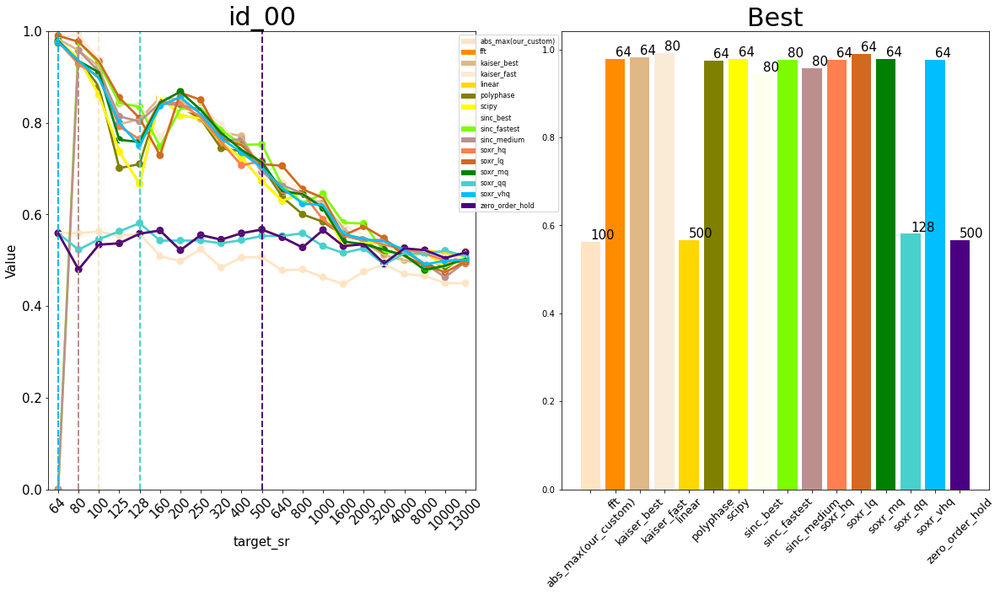

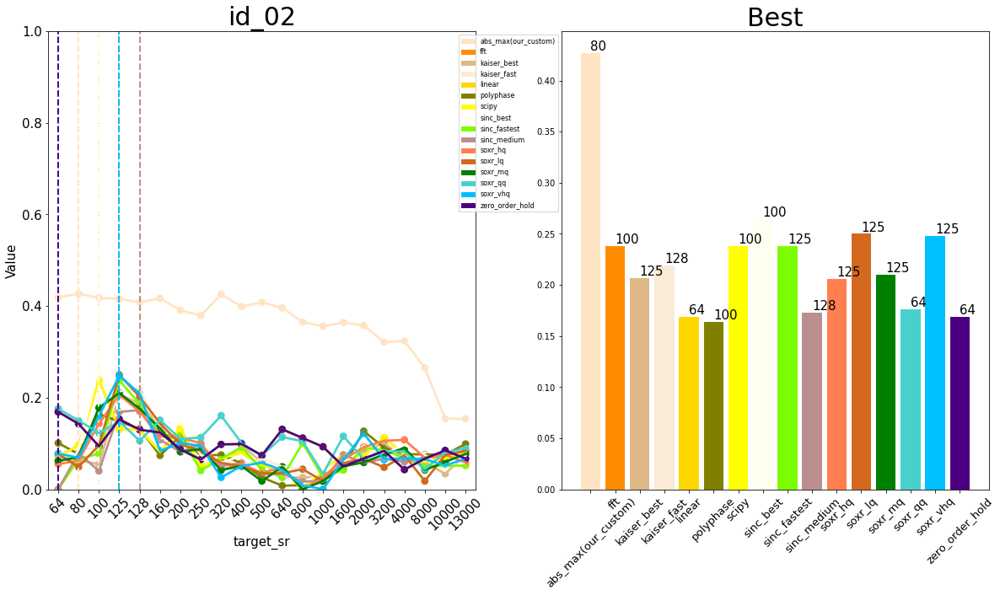

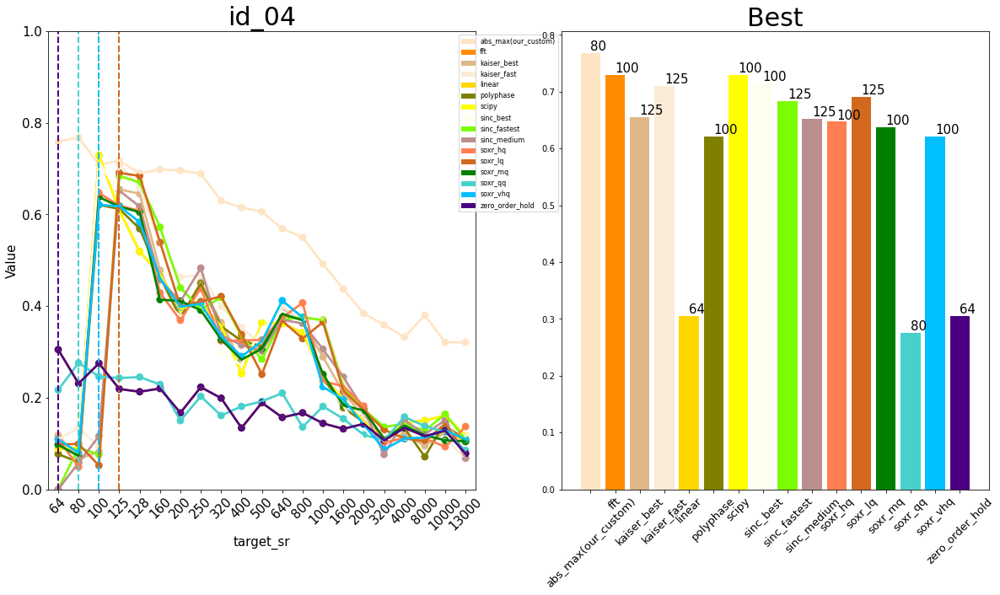

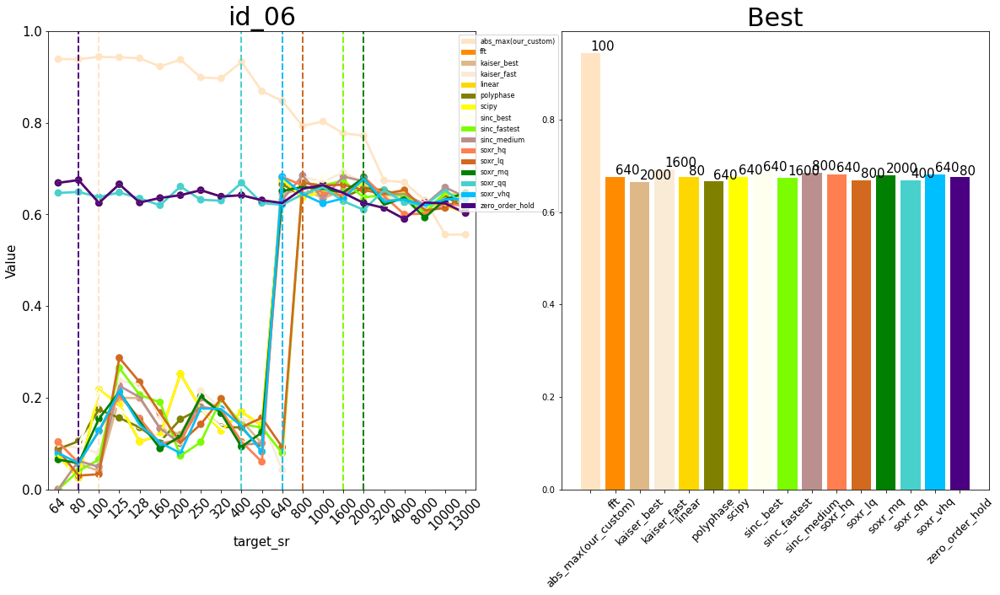

In [33]:
Model_li = ['id_00', 'id_02', 'id_04', 'id_06']
for Model in Model_li:
    ModelPlot(Model)

## Per Noise

In [34]:
## 전처리 및 불러오기 

data = pd.read_csv('/project/time_series/model_all_cases.csv')

def make_Object(x):
    if x[:6] == 'fan_0_':
        object = '0'
    elif x[:6] == 'fan_6_':
        object = '6'
    else :
        object = '_6'
    return object
data['Noise'] = data['Model'].apply(make_Object)
data['Object'] = data['Model'].apply(lambda x : x.split('_')[0])
data['Model'] = data['Model'].apply(lambda x : x[-5:])
data = data[['Object','Noise', 'Model', 'sampling_way', 'target_sr', 'acc', 'recall', 'precision','f1', 'auc_score']]
data.head()

,Object,Noise,Model,sampling_way,target_sr,acc,recall,precision,f1,auc_score
0,fan,0,id_00,abs_max(our_custom),64,0.820,0.390,0.970,0.557,0.744
1,fan,0,id_00,abs_max(our_custom),80,0.820,0.390,0.970,0.557,0.731
2,fan,0,id_00,abs_max(our_custom),100,0.824,0.390,1.000,0.561,0.766
3,fan,0,id_00,abs_max(our_custom),125,0.810,0.366,0.938,0.526,0.786
4,fan,0,id_00,abs_max(our_custom),128,0.817,0.378,0.969,0.544,0.748


In [35]:
def Per_Noise(Noise : str):
    
    target_sr_li = sorted(list(set(data['target_sr'])))
    resample_li = sorted(list(set(data['sampling_way'])))
    
    dic = {}
    for sampling_way in resample_li:
        dic[sampling_way] = []

        for target_sr in target_sr_li: 

            con_noise = data['Noise'] == Noise
            con_sampling_way = data['sampling_way']==sampling_way
            con_trsr = data['target_sr'] == target_sr

            data_new = data[con_noise&con_sampling_way&con_trsr]['f1']
            mu_val = np.around(data_new.mean(), 3)
            dic[sampling_way].append(mu_val)

    mu_val_df = pd.DataFrame(dic, index=target_sr_li)

    color_li = ['bisque', 'darkorange', 'burlywood', 'antiquewhite', 'gold', 'olive', 'yellow', 'ivory', 'lawngreen','rosybrown','coral',
                'chocolate', 'green', 'mediumturquoise', 'deepskyblue', 'indigo']

    fig = plt.figure(figsize=(20, 10))
    axs = fig.subplots(1,2)

    legend_li = []
    maxind_li = []
    maxvalue_li = []

    for column, color in zip(resample_li, color_li) :
        sns.pointplot(x = mu_val_df.index, y=column,data = mu_val_df ,label='{}'.format(column), color = color, ax=axs[0])

        maxind = np.argmax(mu_val_df[column])
        maxind_li.append(maxind)

        maxvalue = mu_val_df[column].iloc[maxind]
        maxvalue_li.append(maxvalue)

        axs[0].axvline(maxind, color=color, linestyle='--', linewidth=2)
        legend_li.append(mpatches.Patch(color=color,label='{}'.format(column)))

    _=axs[0].legend(handles=legend_li, loc='upper right',bbox_to_anchor=(1.2,1), fontsize=8)
    _=axs[0].set_ylabel('Value', fontsize=15)
    _=axs[0].set_xlabel('target_sr', fontsize=15)
    _=axs[0].set_ylim([0,1])


    _=axs[0].set_xticklabels(target_sr_li, fontsize=15, rotation=45)
    _=axs[0].tick_params(axis='y', labelsize=15)
    _=axs[0].set_title('{}'.format(Noise), fontsize=30)

    _=axs[1].bar(range(len(maxind_li)), maxvalue_li, color=color_li)
    for ii, ind in enumerate(maxind_li) :
        axs[1].text(ii, maxvalue_li[ii], '{}'.format(target_sr_li[ii]), ha='left', va='bottom', fontsize=15)


    _=axs[1].set_title('Best', fontsize=30)
    _=axs[1].set_xticks(range(len(maxvalue_li)))
    _=axs[1].set_xticklabels(resample_li, fontsize=13, rotation=45)

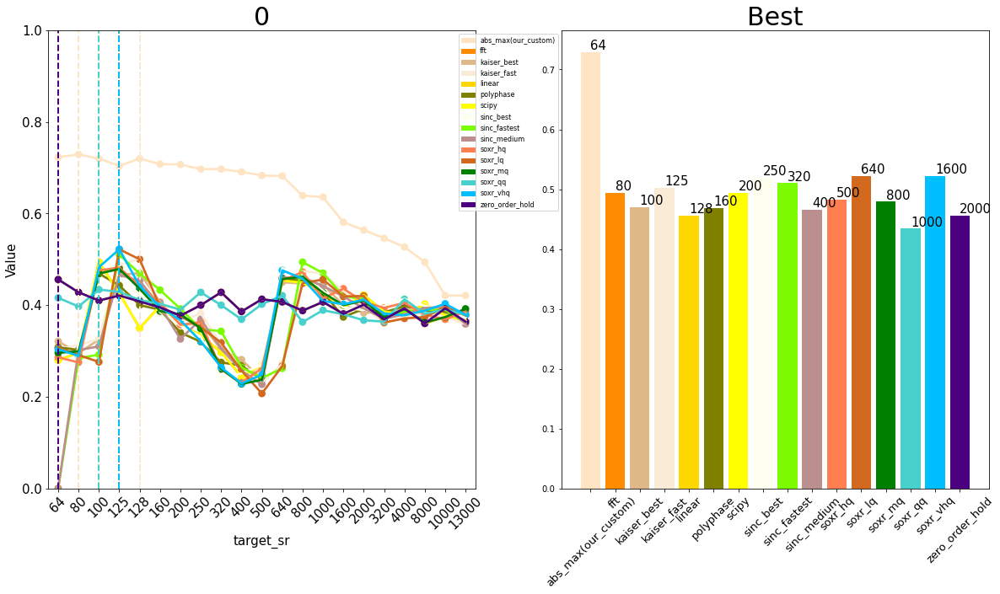

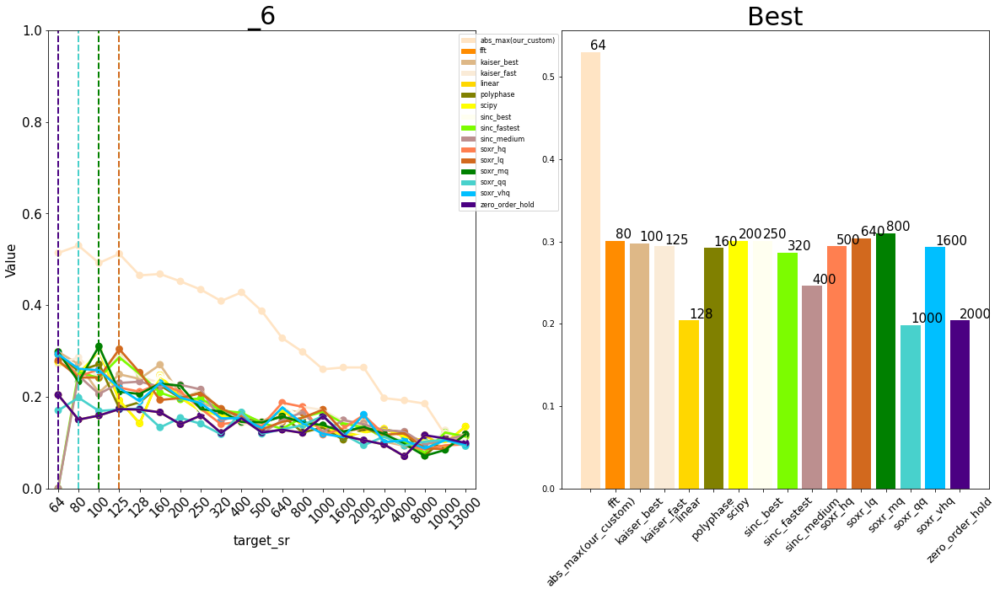

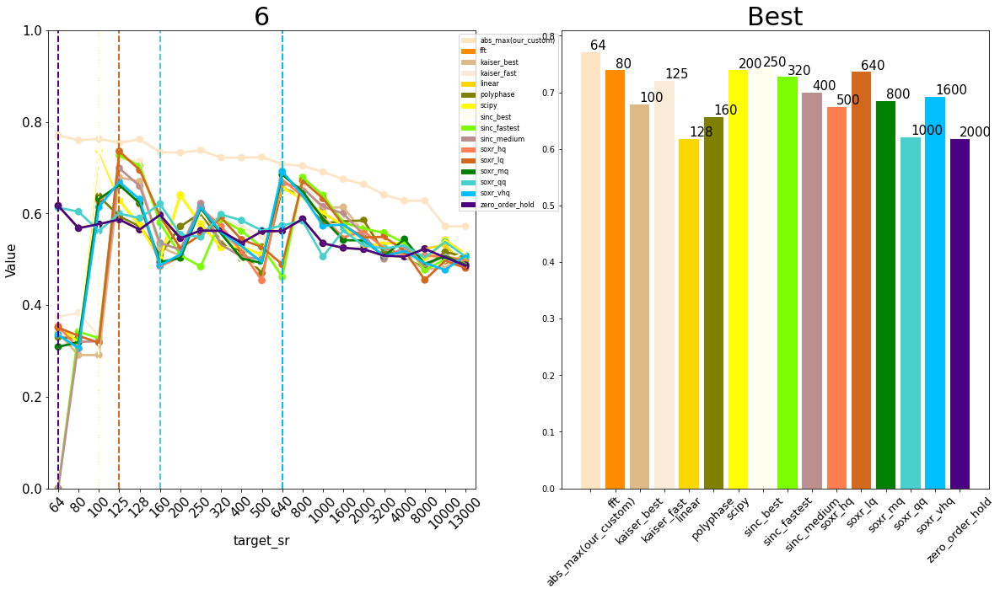

In [36]:
Noise_li = ['0', '_6', '6']

for Noise in Noise_li:
    Per_Noise(Noise)


## For All
- 1개의 그래프만 나온다

In [37]:
## 전처리 및 불러오기 

data = pd.read_csv('/project/time_series/model_all_cases.csv')

def make_Object(x):
    if x[:6] == 'fan_0_':
        object = '0'
    elif x[:6] == 'fan_6_':
        object = '6'
    else :
        object = '_6'
    return object
data['Noise'] = data['Model'].apply(make_Object)
data['Object'] = data['Model'].apply(lambda x : x.split('_')[0])
data['Model'] = data['Model'].apply(lambda x : x[-5:])
data = data[['Object','Noise', 'Model', 'sampling_way', 'target_sr', 'acc', 'recall', 'precision','f1', 'auc_score']]
data.head()

,Object,Noise,Model,sampling_way,target_sr,acc,recall,precision,f1,auc_score
0,fan,0,id_00,abs_max(our_custom),64,0.820,0.390,0.970,0.557,0.744
1,fan,0,id_00,abs_max(our_custom),80,0.820,0.390,0.970,0.557,0.731
2,fan,0,id_00,abs_max(our_custom),100,0.824,0.390,1.000,0.561,0.766
3,fan,0,id_00,abs_max(our_custom),125,0.810,0.366,0.938,0.526,0.786
4,fan,0,id_00,abs_max(our_custom),128,0.817,0.378,0.969,0.544,0.748


In [15]:
data

,Object,Noise,Model,sampling_way,target_sr,acc,recall,precision,f1,auc_score
0,fan,0,id_00,abs_max(our_custom),64,0.820,0.390,0.970,0.557,0.744
1,fan,0,id_00,abs_max(our_custom),80,0.820,0.390,0.970,0.557,0.731
2,fan,0,id_00,abs_max(our_custom),100,0.824,0.390,1.000,0.561,0.766
3,fan,0,id_00,abs_max(our_custom),125,0.810,0.366,0.938,0.526,0.786
4,fan,0,id_00,abs_max(our_custom),128,0.817,0.378,0.969,0.544,0.748
...,...,...,...,...,...,...,...,...,...,...
4027,fan,6,id_06,soxr_qq,3200,0.967,0.875,1.000,0.933,0.999
4028,fan,6,id_06,soxr_qq,4000,0.971,0.889,1.000,0.941,0.996
4029,fan,6,id_06,soxr_qq,8000,0.964,0.875,0.984,0.926,0.999
4030,fan,6,id_06,soxr_qq,10000,0.975,0.903,1.000,0.949,0.996


In [38]:
target_sr_li = sorted(list(set(data['target_sr'])))
resample_li = list(set(data['sampling_way']))

dic = {}
for sampling_way in resample_li:
    dic[sampling_way] = []

    for target_sr in target_sr_li: 

#         con_noise = data['Noise'] == Noise
        con_sampling_way = data['sampling_way']==sampling_way
        con_trsr = data['target_sr'] == target_sr

        data_new = data[con_sampling_way&con_trsr]['f1']
        mu_val = np.around(data_new.mean(), 3)
        dic[sampling_way].append(mu_val)

mu_val_df = pd.DataFrame(dic, index=target_sr_li)

In [39]:
mu_val_df

,scipy,kaiser_best,sinc_fastest,soxr_mq,soxr_hq,soxr_qq,kaiser_fast,linear,soxr_lq,polyphase,zero_order_hold,sinc_medium,fft,abs_max(our_custom),soxr_vhq,sinc_best
64,0.303,0.319,0.000,0.301,0.311,0.400,0.317,0.426,0.312,0.310,0.426,0.000,0.303,0.669,0.311,0.000
80,0.288,0.286,0.293,0.284,0.275,0.400,0.327,0.382,0.289,0.295,0.382,0.289,0.288,0.673,0.286,0.304
100,0.511,0.275,0.287,0.470,0.455,0.388,0.299,0.382,0.279,0.460,0.382,0.279,0.511,0.658,0.452,0.520
125,0.416,0.465,0.508,0.451,0.455,0.400,0.500,0.394,0.521,0.404,0.394,0.465,0.416,0.657,0.470,0.439
128,0.355,0.460,0.474,0.422,0.425,0.392,0.486,0.382,0.483,0.387,0.382,0.448,0.355,0.649,0.421,0.412
160,0.382,0.401,0.407,0.370,0.373,0.386,0.399,0.386,0.394,0.375,0.386,0.385,0.382,0.637,0.371,0.375
200,0.399,0.357,0.365,0.369,0.358,0.366,0.362,0.354,0.366,0.370,0.354,0.358,0.399,0.631,0.359,0.363
250,0.360,0.388,0.343,0.378,0.383,0.373,0.396,0.374,0.372,0.377,0.374,0.402,0.360,0.623,0.374,0.367
320,0.327,0.342,0.367,0.328,0.324,0.372,0.358,0.370,0.361,0.328,0.370,0.329,0.327,0.609,0.325,0.314
400,0.306,0.323,0.330,0.292,0.298,0.373,0.326,0.358,0.319,0.314,0.358,0.308,0.306,0.614,0.304,0.300


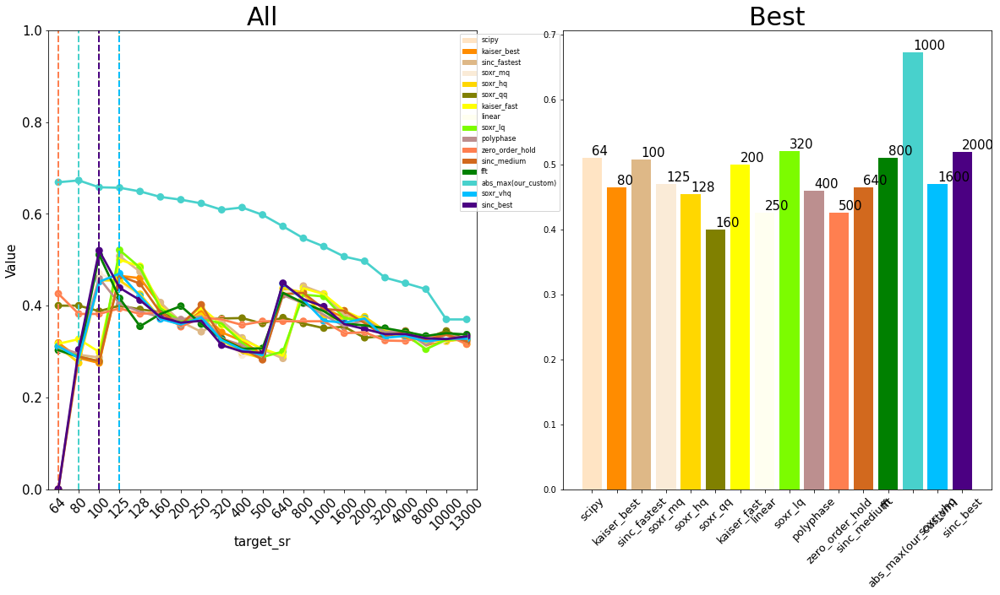

In [40]:
color_li = ['bisque', 'darkorange', 'burlywood', 'antiquewhite', 'gold', 'olive', 'yellow', 'ivory', 'lawngreen','rosybrown','coral',
            'chocolate', 'green', 'mediumturquoise', 'deepskyblue', 'indigo']

fig = plt.figure(figsize=(20, 10))
axs = fig.subplots(1,2)

legend_li = []
maxind_li = []
maxvalue_li = []

for column, color in zip(resample_li, color_li) :
    sns.pointplot(x = mu_val_df.index, y=column,data = mu_val_df ,label='{}'.format(column), color = color, ax=axs[0])

    maxind = np.argmax(mu_val_df[column])
    maxind_li.append(maxind)

    maxvalue = mu_val_df[column].iloc[maxind]
    maxvalue_li.append(maxvalue)

    axs[0].axvline(maxind, color=color, linestyle='--', linewidth=2)
    legend_li.append(mpatches.Patch(color=color,label='{}'.format(column)))

_=axs[0].legend(handles=legend_li, loc='upper right',bbox_to_anchor=(1.2,1), fontsize=8)
_=axs[0].set_ylabel('Value', fontsize=15)
_=axs[0].set_xlabel('target_sr', fontsize=15)
_=axs[0].set_ylim([0,1])


_=axs[0].set_xticklabels(target_sr_li, fontsize=15, rotation=45)
_=axs[0].tick_params(axis='y', labelsize=15)
_=axs[0].set_title('All', fontsize=30)

_=axs[1].bar(range(len(maxind_li)), maxvalue_li, color=color_li)
for ii, ind in enumerate(maxind_li) :
    axs[1].text(ii, maxvalue_li[ii], '{}'.format(target_sr_li[ii]), ha='left', va='bottom', fontsize=15)


_=axs[1].set_title('Best', fontsize=30)
_=axs[1].set_xticks(range(len(maxvalue_li)))
_=axs[1].set_xticklabels(resample_li, fontsize=13, rotation=45)